In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.misc import *
import colorsys
import glob
from sklearn import cluster
import random 

%matplotlib inline

# Exploratory Data Analysis
- There are night and day images, if we want to train a CNN:
  - 1st solution: we can make all images night looking like 
  - 2nd solution: build two separate models for night and day photos
- The size of images are different, it could be an indication of the Boat

notebook summary:
- 1) plotting few images (examples)
- 2) plotting images turned to green
- 3) detection of night/day images using

## Plotting few images

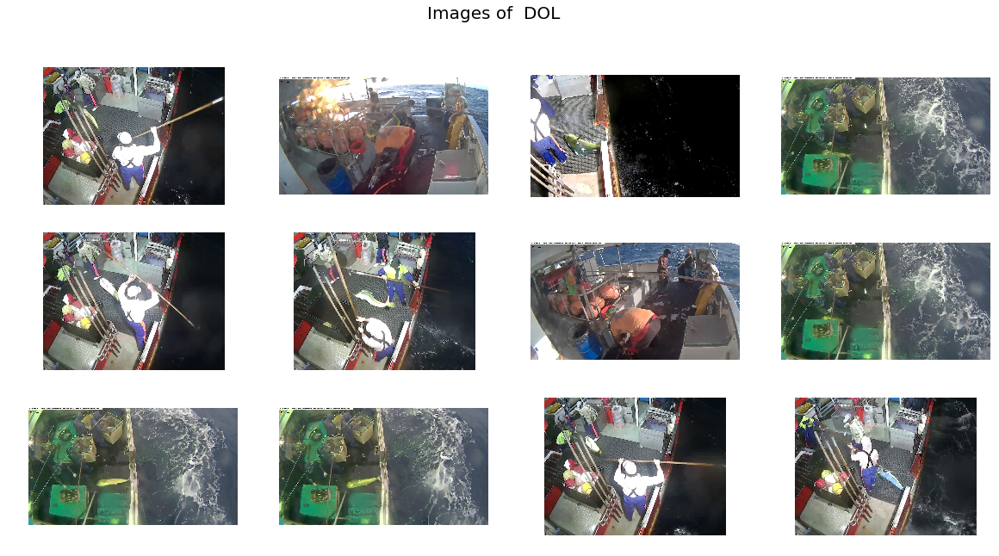

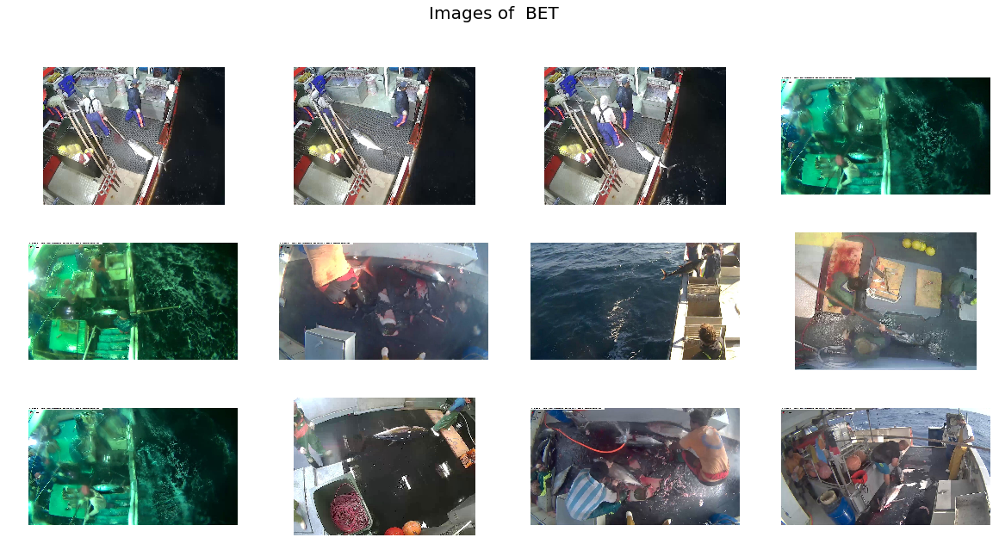

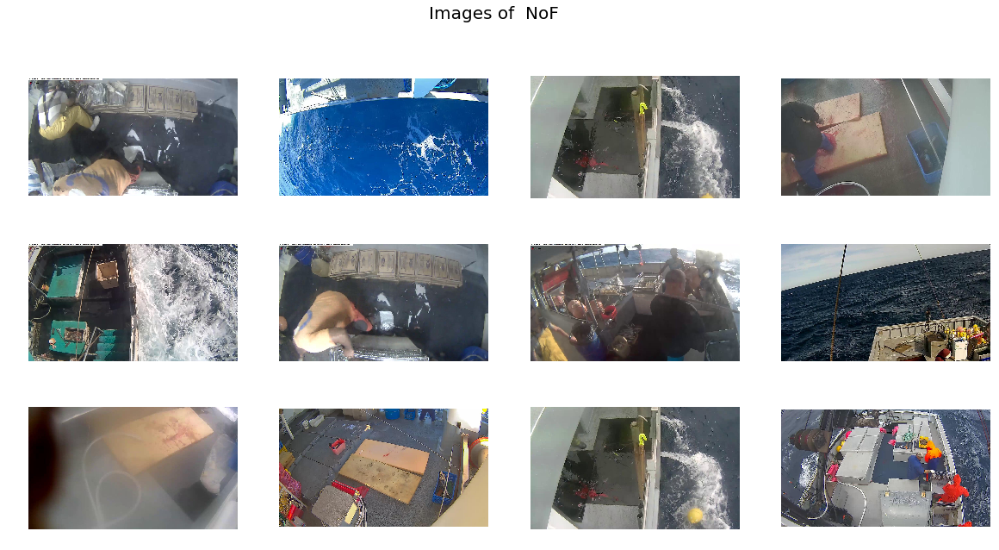

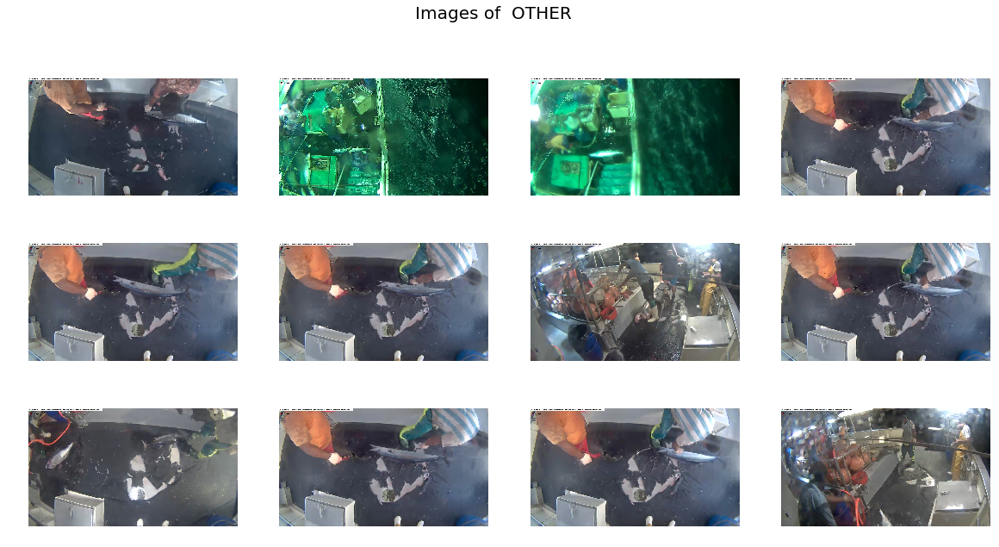

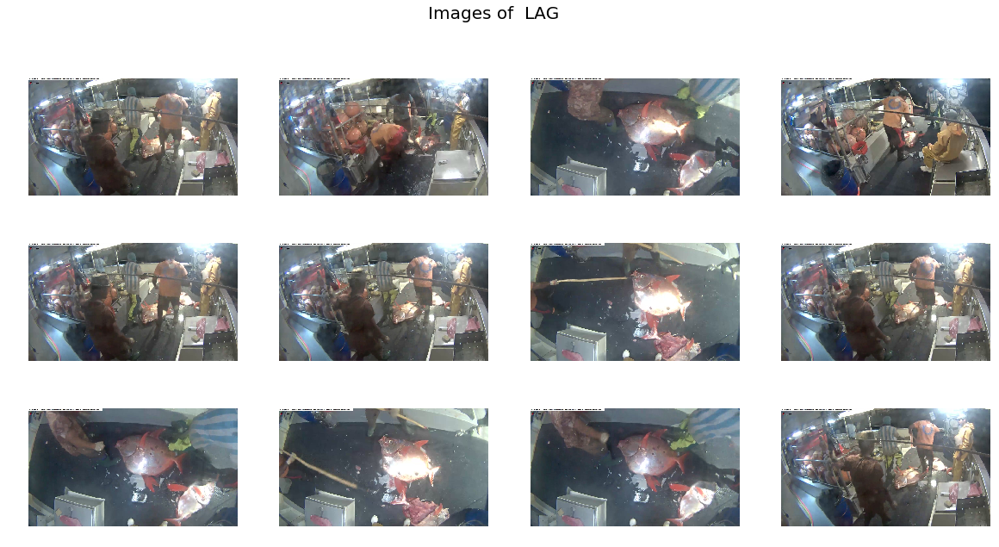

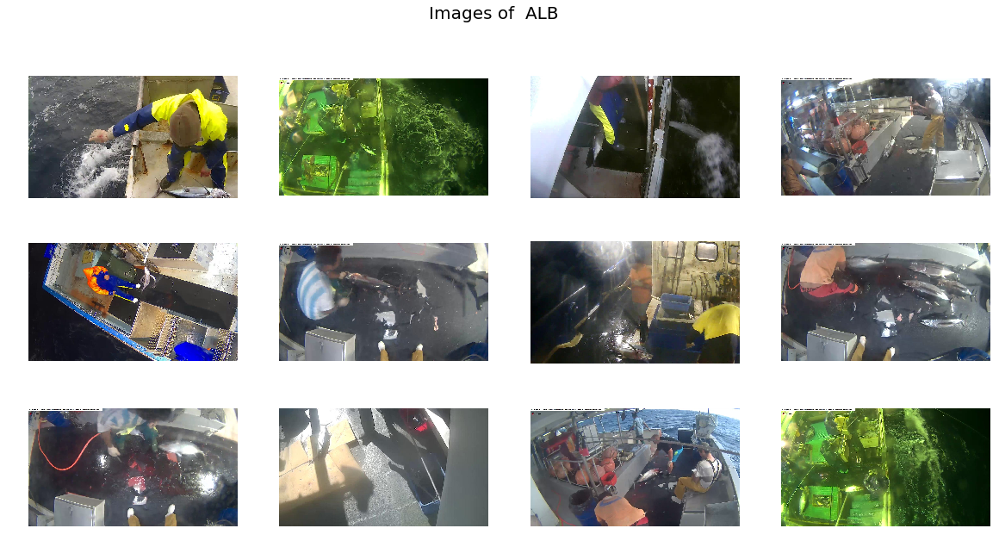

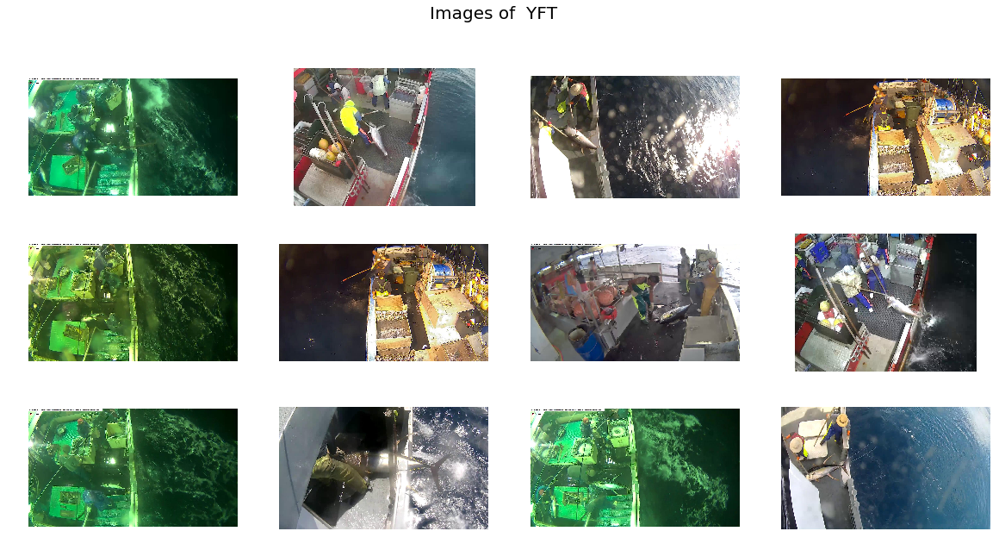

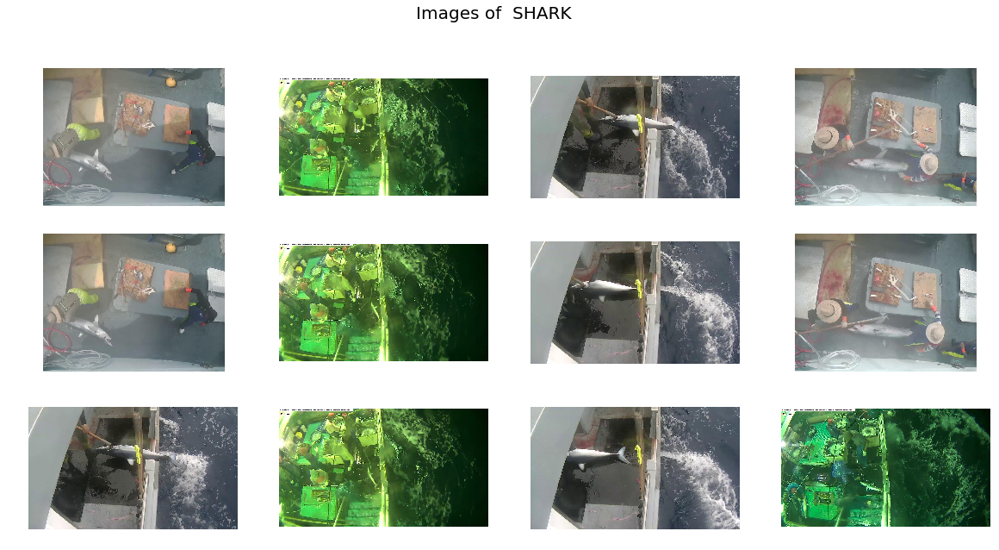

In [2]:
rows = len(os.listdir('./train'))
#fig, ax = plt.subplots(rows, 3, figsize=(20, 30))
#ax = ax.ravel()

for s in os.listdir('./train'):
    images = os.listdir('./train/' + s)[:12]
    fig, ax = plt.subplots(3, 4, figsize=(20, 10))
    ax = ax.ravel()
    plt.suptitle('Images of  ' + s, size=20)
    cmp = 0
    for idx, img in enumerate(images):
        picture = imread('./train/' + s + '/' + img)
        ax[cmp].axis('off')
        ax[cmp].imshow(picture)
        cmp += 1

## Plotting images turned to "green"

In [3]:
def make_night_img(img):
    width, height = img.shape[:2]
    for y in range(height):
        for x in range(width):
            r,g,b = img[x,y]
            h,s,v = colorsys.rgb_to_hsv(r/255., g/255., b/255.)
            h = (h + -90.0/360.0) % 1.0   # hue
            s = s**0.25                   # saturation
            r,g,b = colorsys.hsv_to_rgb(h, s, v)
            img[x,y] = (int(r * 255.9999), int(g * 255.9999), int(b * 255.9999))
    return(img)

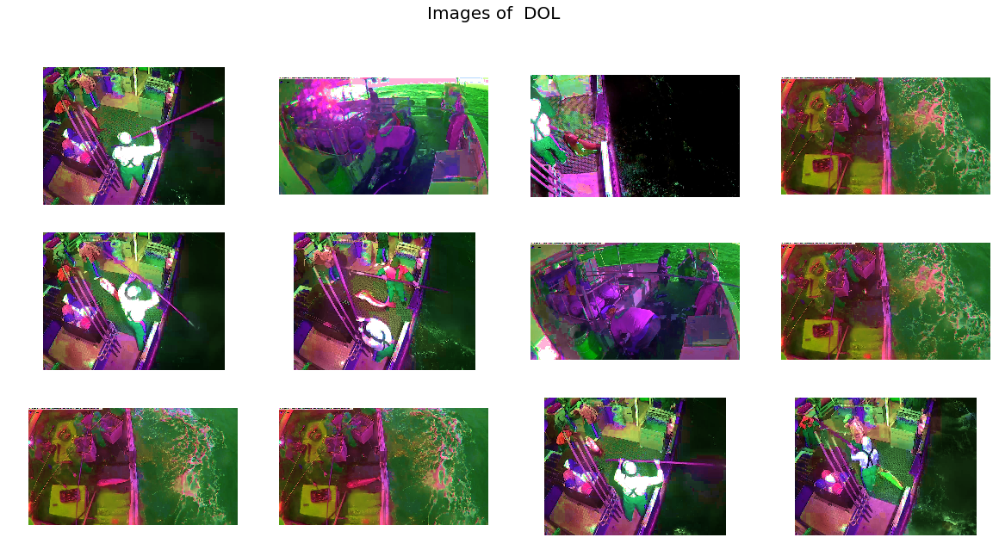

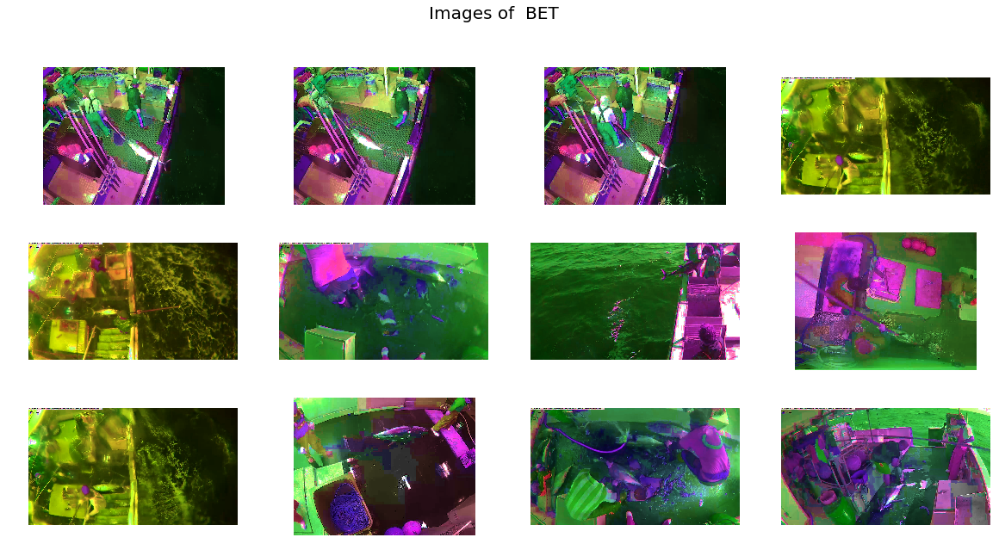

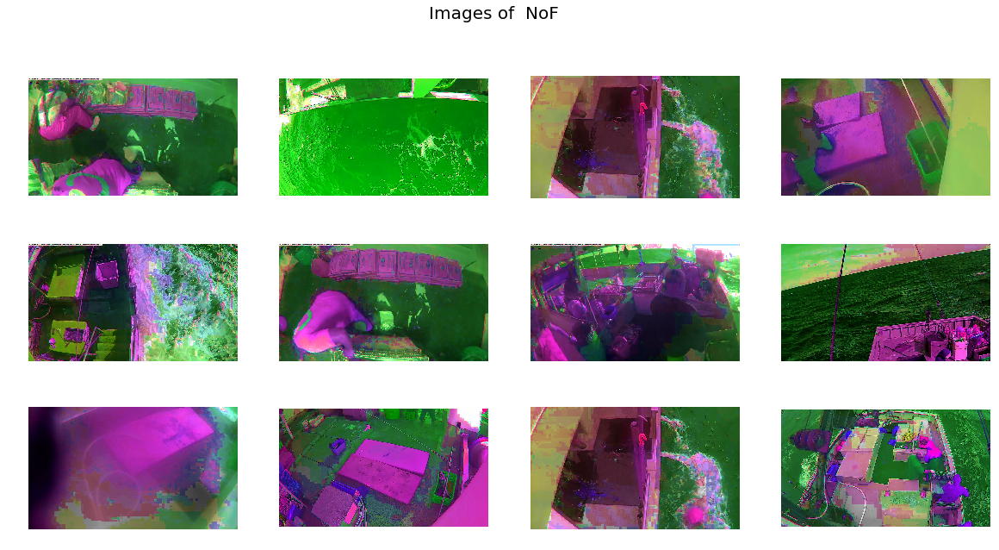

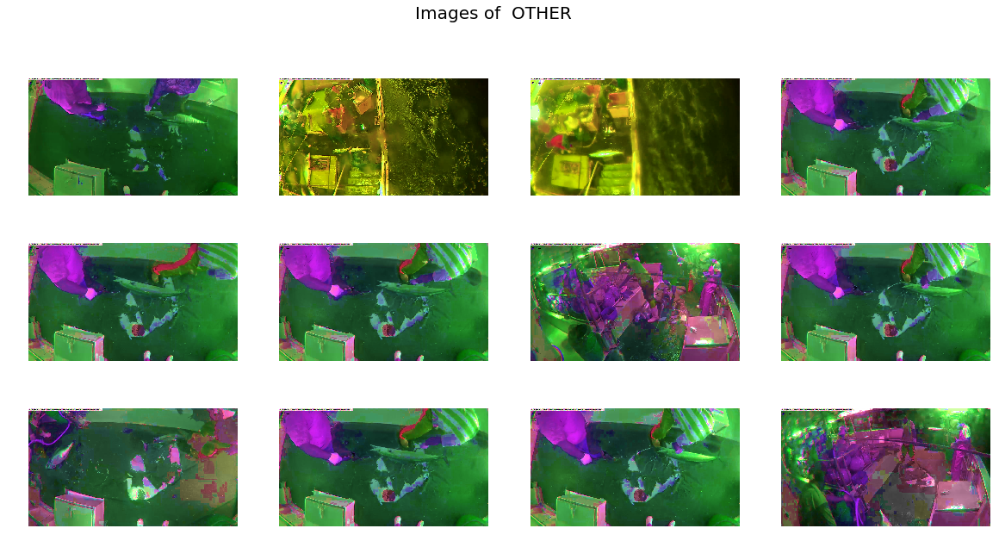

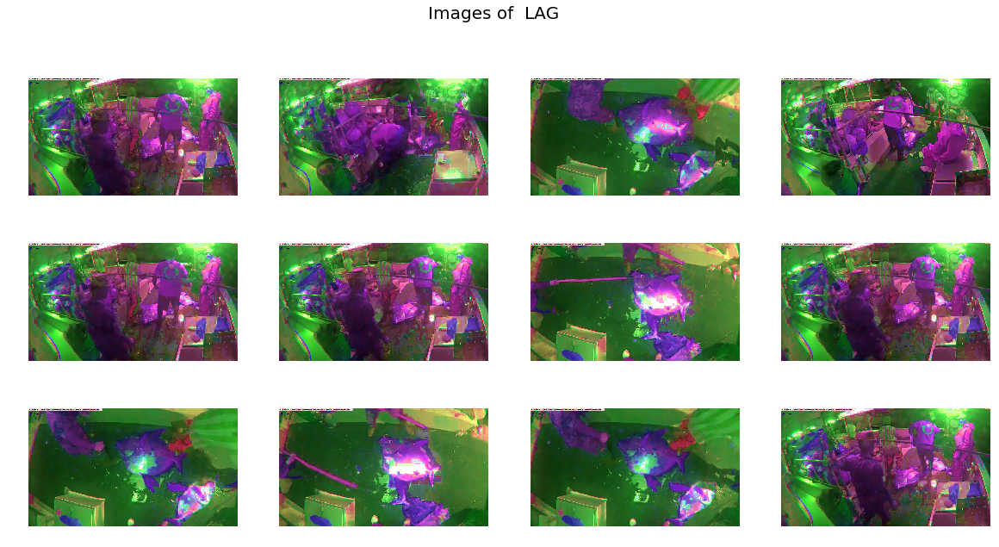

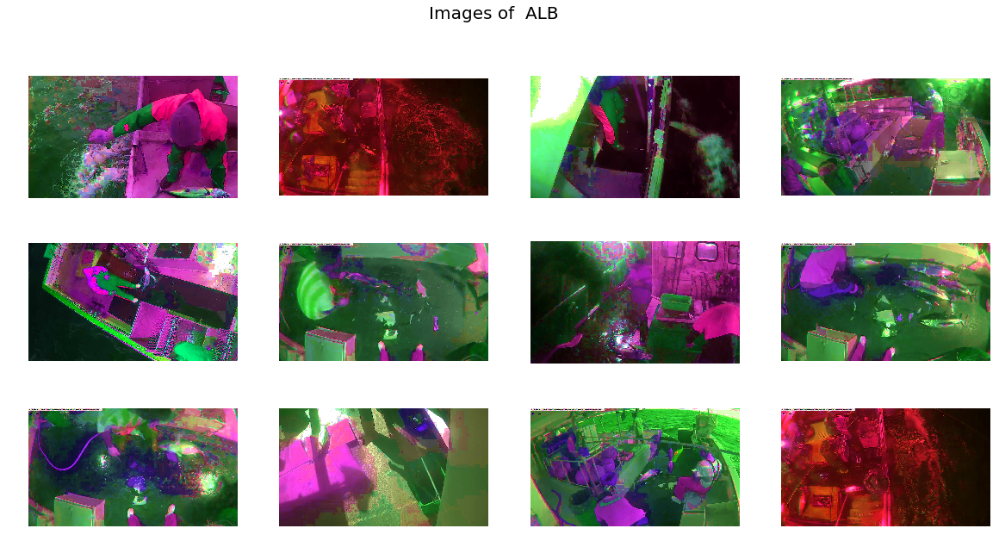

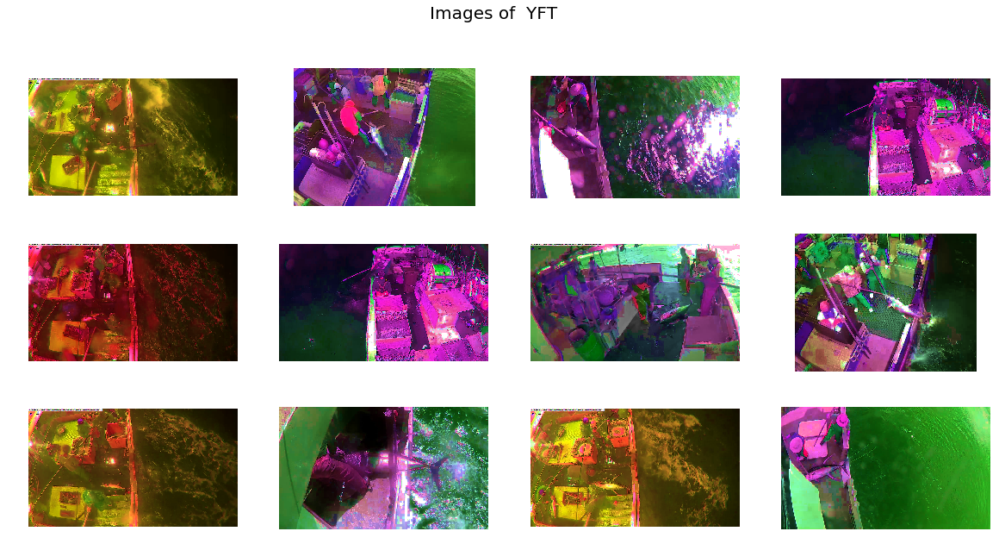

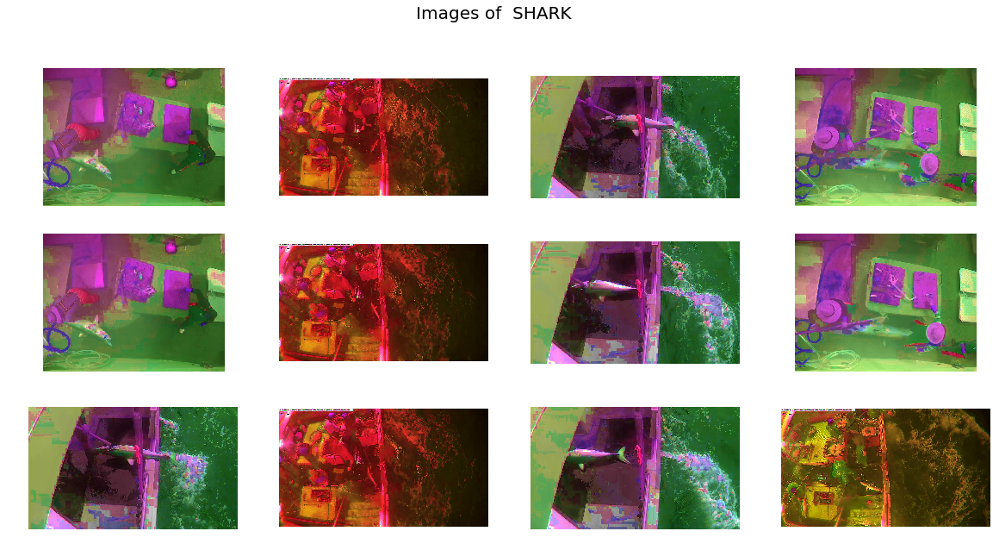

In [5]:
for s in os.listdir('./train'):
    images = os.listdir('./train/' + s)[:12]
    fig, ax = plt.subplots(3, 4, figsize=(20, 10))
    ax = ax.ravel()
    plt.suptitle('Images of  ' + s, size=20)
    cmp = 0
    for idx, img in enumerate(images):
        picture = imread('./train/' + s + '/' + img)
        picture = make_night_img(picture)
        ax[cmp].axis('off')
        ax[cmp].imshow(picture)
        cmp += 1

## Detection of night and day images
As the green channel seems to be stronger for night images, we can use kmean to create two clusters (cluster 0 if day image, and cluster 1 if night image). Here below, we will try the highlight the green channel dominance. For each chanel, we will substract it mean to the mean of the two other channels. Thus, the night photos will present strong green channel dominancy, whereas day photos will be penalized.

Preparing training features ...
Fitting Kmeans ...
showing examples


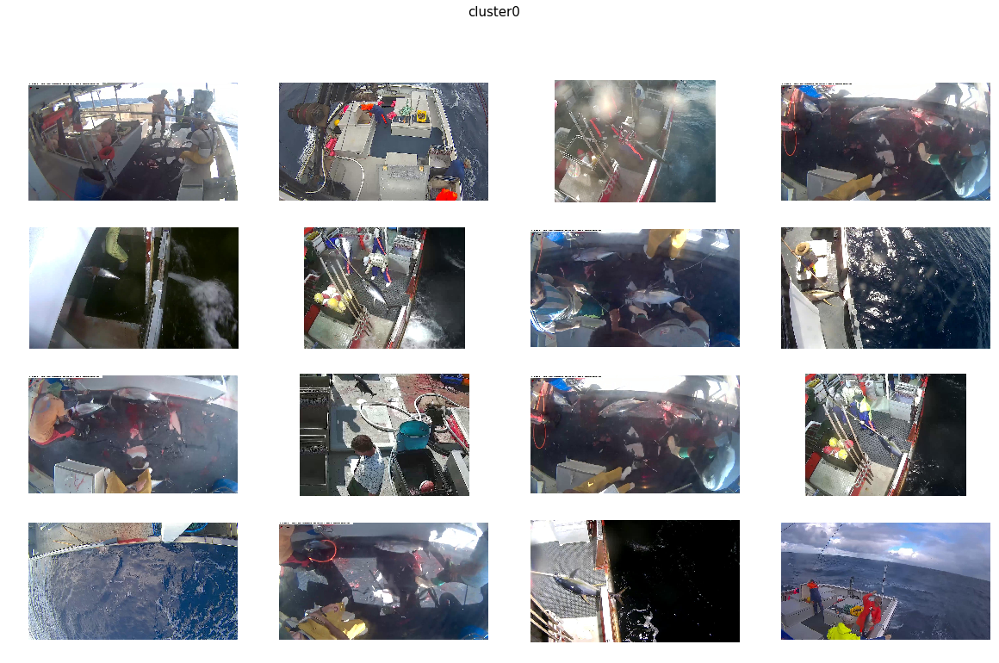

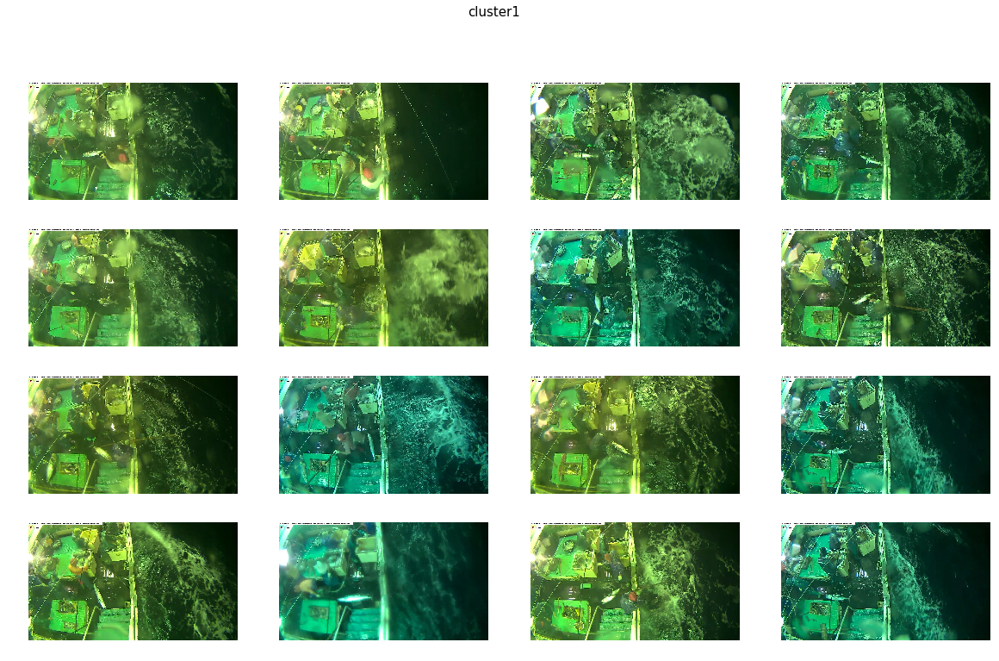

In [6]:
n_cls = 2
training_imgs = 500

training_files = sorted(glob.glob('./train/*/*.jpg'), key=lambda x: random.random())[:training_imgs]
training = np.array([imread(img) for img in training_files])
training_means = np.array([np.mean(img, axis=(0, 1)) for img in training])
training_features = np.zeros((training_imgs, 3))

print('Preparing training features ...')

for i in range(training_imgs):
    training_features[i][0] = (training_means[i][0] - training_means[i][1])
    training_features[i][0] += (training_means[i][0] - training_means[i][2])
    training_features[i][1] = (training_means[i][1] - training_means[i][0])
    training_features[i][1] += (training_means[i][1] - training_means[i][2])
    training_features[i][2] = (training_means[i][2] - training_means[i][0])
    training_features[i][2] += (training_means[i][2] - training_means[i][1])

print('Fitting Kmeans ...')
kmeans = cluster.KMeans(n_clusters=n_cls).fit(training_features)

print('showing examples')
def show_clusters(imgs, title):
    fig, ax = plt.subplots(4, 4, figsize=(20, 12))
    ax = ax.ravel()
    plt.suptitle(title, size=15)
    for i, img in enumerate(imgs):
        ax[i].axis('off')
        ax[i].imshow(img)

for i in range(n_cls):
    cluster_i = training[np.where(kmeans.labels_ == i)]
    show_clusters(cluster_i[:16], 'cluster' + str(i))

In [8]:
import cv2
img = cv2.imread('home.jpg')
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

ImportError: No module named 'cv2'